# Package installation



In [ ]:
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions

!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html

# Used to split the train folder into test-validation
!pip install split-folders

# Some basic setup for detectron2:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html


# Run a pre-trained detectron2 model

In [ ]:
# Remove folders and its contents if they already exist to avoid duplicate data
!rm -r "Detection_Train_Set_Img"
!rm -r "Detection_Val_Set_Img"
!rm -r "Detection_Train_Set_Json"
!rm -r "output"
!rm -r "in"

rm: cannot remove 'Detection_Train_Set_Img': No such file or directory
rm: cannot remove 'Detection_Val_Set_Img': No such file or directory
rm: cannot remove 'Detection_Train_Set_Json': No such file or directory
rm: cannot remove 'output': No such file or directory
rm: cannot remove 'in': No such file or directory


In [ ]:
# For training, the prerrequisite is to upload to the envirnoment to zip files:
# One zip file containing the train set images and other file containing the
# annotations in json format for each of the images. 

# The following lines unzip the folders
!unzip Detection_Train_Set_Img.zip
!unzip Detection_Train_Set_Json.zip

Archive:  Detection_Train_Set_Img.zip
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3049.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3059.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3064.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3069.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3074.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3079.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3084.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3089.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3094.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_BIofiltration_18mois_05frame3099.jpg  
  inflating: Detection_Train_Set_Img/Batch2__BioSAV_

In [ ]:

import shutil
import splitfolders

# Create the folders needed for the splitfolders to work
!mkdir "in"
!mkdir "in/input"

file_list=os.listdir("Detection_Train_Set_Img")

# Move each file in the original folder
for idx, f in enumerate(file_list):
  shutil.move("Detection_Train_Set_Img/" + f, "in/input/" + f)

# Split the folders (80% train, 20% validation)
splitfolders.ratio('in', output="output", seed=1337, ratio=(.8, .2))

# Create the validation folder
!mkdir "Detection_Val_Set_Img"

# From the split folder output move the images to the train folder
file_list=os.listdir("output/train/input")
for idx, f in enumerate(file_list):
  shutil.move("output/train/input/" + f, "Detection_Train_Set_Img/" + f)

# Do the same with the validation images
file_list=os.listdir("output/val/input")
for idx, f in enumerate(file_list):
  shutil.move("output/val/input/" + f, "Detection_Val_Set_Img/" + f)

# Remove the empty folders
!rm -r in
!rm -r output

Copying files: 1232 files [00:01, 864.19 files/s] 


In [ ]:
from collections import Iterable

# Auxiliary function to flatten the lists, it is used to modify the
# json file and extract the relevant information to create the COCO dataset
# needed by the detectron model.
def flatten(lis):
     for item in lis:
         if isinstance(item, Iterable) and not isinstance(item, str):
             for x in flatten(item):
                 yield x
         else:        
             yield item

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  """Entry point for launching an IPython kernel.


In [ ]:
import json, os
import pandas as pd

# Function for the train data to register the dataset
def dataset_function_train():
  json_folder = r"Detection_Train_Set_Json"
  img_folder = r"Detection_Train_Set_Img"
  
  # Extract the images names from a folder
  file_list=os.listdir(img_folder)
  
  dataset_dicts = []
  # From the names extract the json file names and extract the relevant annotations:
  for idx, f in enumerate(file_list):
    # Find the json file related to the image
    json_file_path = json_folder + "/" + f + ".json"
    jsonfile = open(json_file_path)
    
    
    # Values will have all the data from the json file
    values = json.load(jsonfile)
    
    # We read the image to get the metadata for the annotations and dataset registering
    height, width = cv2.imread(img_folder + "/" + f).shape[:2]
    
    # With the format that is needed for the detectron2 (filename, image_id, height, weight)
    record = {}
    record["file_name"] = img_folder + "/" + f
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width
    
    objs = []
    # Iterate over all the objects in the json file to filter out only the people and get their bbox
    # also set category_id as 0 because we only want to identify people.
    for obj in values['objects']:
      if obj['classTitle'] == 'People':
        ob = {"bbox": list(flatten(obj['points']['exterior'])),
              "bbox_mode": BoxMode.XYXY_ABS,
              "category_id": 0 }
        objs.append(ob)
    record["annotations"] = objs
    # dataset_dicts will have all the anotations from the image folder.
    if len(objs) > 0:
      dataset_dicts.append(record)
  return dataset_dicts

# Function for the validation data to register the dataset
def dataset_function_val():
  json_folder = r"Detection_Train_Set_Json"
  img_folder = r"Detection_Val_Set_Img"
  
  # Extract the images names from a folder
  file_list=os.listdir(img_folder)
  
  dataset_dicts = []
  # From the names extract the json file names and extract the relevant annotations:
  for idx, f in enumerate(file_list):
    # Find the json file related to the image
    json_file_path = json_folder + "/" + f + ".json"
    jsonfile = open(json_file_path)
    
    
    # Values will have all the data from the json file
    values = json.load(jsonfile)
    
    # We read the image to get the metadata for the annotations and dataset registering
    height, width = cv2.imread(img_folder + "/" + f).shape[:2]
    
    # With the format that is needed for the detectron2 (filename, image_id, height, weight)
    record = {}
    record["file_name"] = img_folder + "/" + f
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width
    
    objs = []
    # Iterate over all the objects in the json file to filter out only the people and get their bbox
    # also set category_id as 0 because we only want to identify people.
    for obj in values['objects']:
      if obj['classTitle'] == 'People':
        ob = {"bbox": list(flatten(obj['points']['exterior'])),
              "bbox_mode": BoxMode.XYXY_ABS,
              "category_id": 0 }
        objs.append(ob)
    record["annotations"] = objs
    # dataset_dicts will have all the anotations from the image folder.
    if len(objs) > 0:
      dataset_dicts.append(record)
  return dataset_dicts

In [ ]:
# Dataset registration, we use the previous functions to create them
DatasetCatalog.register( "Image_train", dataset_function_train)
MetadataCatalog.get("Image_train").set(thing_classes=["person"])

DatasetCatalog.register( "Image_val", dataset_function_val)
MetadataCatalog.get("Image_val").set(thing_classes=["person"])

worksites_metadata = MetadataCatalog.get("Image_train")

Detection_Train_Set_Img/Batch2__Marseille_01frame1073.jpg


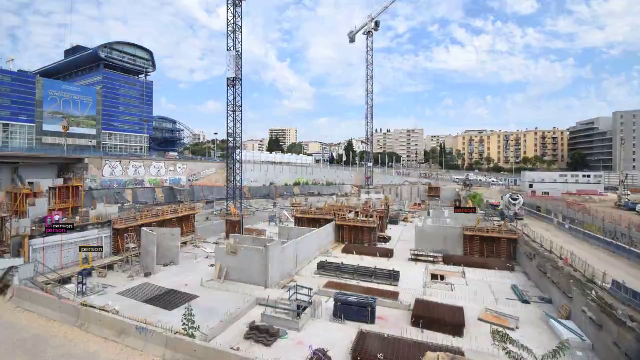

Detection_Train_Set_Img/Batch2__Devisubox2_06frame593.jpg


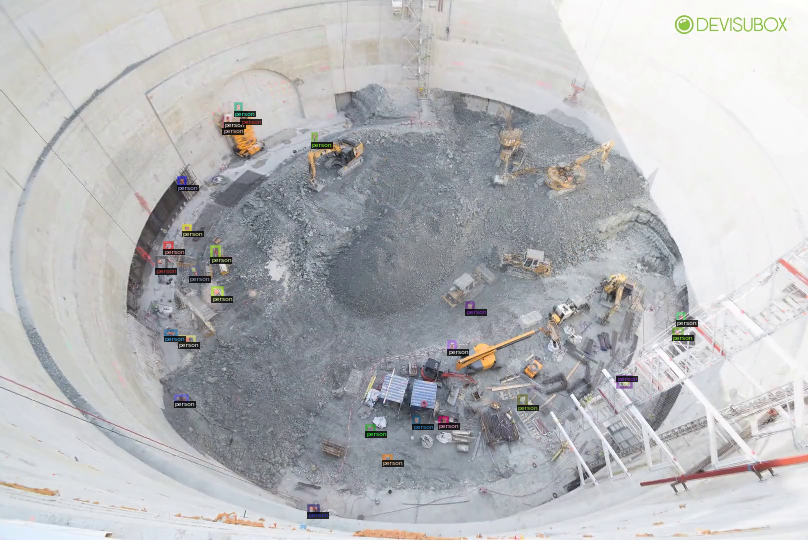

In [ ]:
# Auxiliary step to review the data tha is contained in the
# train dataset that was previously registered
# We can see the images with their annotations of people in the images.
dataset_dicts = dataset_function_train()
for d in random.sample(dataset_dicts, 2):
  print(d['file_name'])
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=worksites_metadata, scale=0.5)
  out = visualizer.draw_dataset_dict(d)
  cv2_imshow(out.get_image()[:, :, ::-1])

## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the worksites dataset.


In [ ]:
# After registering the datasets (Train and val), we proceed to train
# 1. Define the configuration parameters prior to the training
# 2. Train the detectron2 NN with the dataset tha was registered previously

from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")) 
cfg.DATASETS.TRAIN = ("Image_train",)
cfg.DATASETS.TEST = ("Image_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 600    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[02/17 20:22:26 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:22, 18.4MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_pre

[02/17 20:23:20 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[02/17 20:23:43 d2.utils.events]:  eta: 0:11:03  iter: 19  total_loss: 1.724  loss_cls: 0.6699  loss_box_reg: 0.2619  loss_rpn_cls: 0.4456  loss_rpn_loc: 0.2189  time: 1.1289  data_time: 0.0317  lr: 8.1588e-06  max_mem: 6060M
[02/17 20:24:05 d2.utils.events]:  eta: 0:10:38  iter: 39  total_loss: 1.649  loss_cls: 0.5992  loss_box_reg: 0.2191  loss_rpn_cls: 0.312  loss_rpn_loc: 0.3101  time: 1.0991  data_time: 0.0147  lr: 1.6484e-05  max_mem: 6060M
[02/17 20:24:27 d2.utils.events]:  eta: 0:10:15  iter: 59  total_loss: 1.09  loss_cls: 0.5051  loss_box_reg: 0.2381  loss_rpn_cls: 0.1518  loss_rpn_loc: 0.217  time: 1.1023  data_time: 0.0204  lr: 2.4809e-05  max_mem: 6250M
[02/17 20:24:49 d2.utils.events]:  eta: 0:09:52  iter: 79  total_loss: 1.06  loss_cls: 0.3923  loss_box_reg: 0.2225  loss_rpn_cls: 0.1519  loss_rpn_loc: 0.2262  time: 1.1010  data_time: 0.0117  lr: 3.3134e-05  max_mem: 6250M
[02/17 20:25:09 d2.utils.events]:  eta: 0:09:28  iter: 99  total_loss: 1.216  loss_cls: 0.3674  loss

In [ ]:
# Tensorboard provides a dashboard to review the results of the trainin epochs.
# We found it amazing to review how the training was handled throughout the iterations

%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:

# We set a threshold 0.7. Everything detected as person with a probability higher
# than 0.7 will be considered as a person.

# Also it is saved the model weights in an output file. 
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7 
cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

Detection_Val_Set_Img/Batch2__Devisubox2_06frame5650.jpg


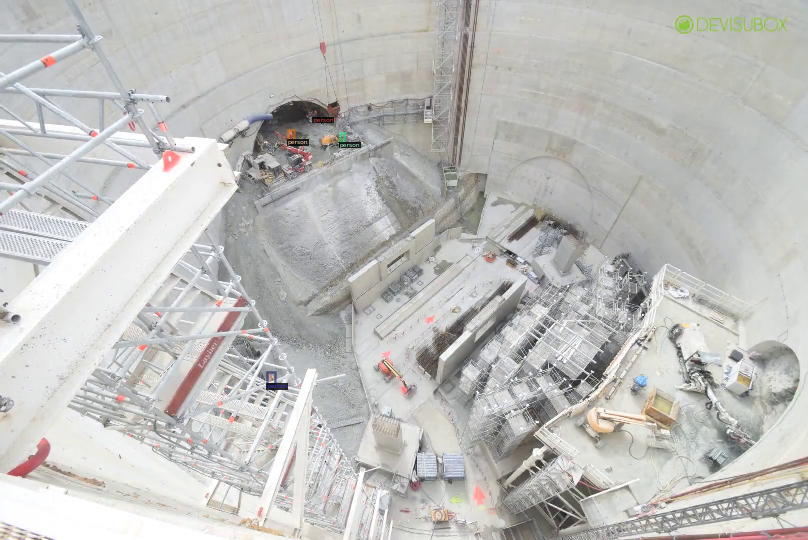

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Detection_Val_Set_Img/Batch2__Marseille_01frame1206.jpg


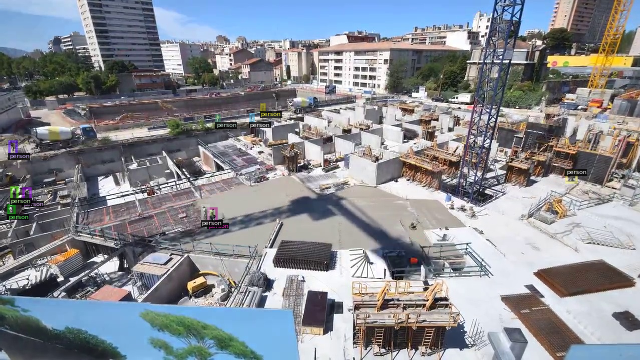

In [ ]:
# This is used to validate visually the performance of our model when predicting
# on new data. There is another colab file where we computed the metrics.

dataset_dicts = dataset_function_val()
for d in random.sample(dataset_dicts, 2):
  print(d['file_name'])
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=worksites_metadata, scale=0.5)
  out = visualizer.draw_dataset_dict(d)
  cv2_imshow(out.get_image()[:, :, ::-1])

  outputs = predictor(img) 
  v = Visualizer(img[:, :, ::-1], metadata=worksites_metadata, scale=0.5, 
                 #instance_mode=ColorMode.IMAGE_BW
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

Cluster Test Images

In [ ]:
# Now, we need to cluster the images that come from the test set.
# This clustering involves 3 steps:
# 1. Using VGG16 without the last layer to get the main features of 
#    each image
# 2. Using dimensionality reduction techniques with PCA algorithm to reduce
#    the 4092 features to 100.
# 3. Use k-means algorithm to group the images into the 7 locations.

# Imports
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

from keras.applications.vgg16 import VGG16 
from keras.models import Model

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd

In [ ]:
# This is the folder where the images are saved
# First it it comes to unzip the images 
path = r"Detection_Test_Set_Img/"

!unzip Detection_Test_Set_Img.zip

Archive:  Detection_Test_Set_Img.zip
  inflating: Detection_Test_Set_Img/2019-10-17-13-30-11.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-13-42-19.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-13-54-13.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-14-06-24.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-14-18-46.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-14-30-46.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-14-42-56.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-14-55-14.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-15-07-15.jpg  
  inflating: Detection_Test_Set_Img/2019-10-17-15-19-05.jpg  
  inflating: Detection_Test_Set_Img/2020-07-15-11-23-38.jpg  
  inflating: Detection_Test_Set_Img/2020-07-15-11-33-43.jpg  
  inflating: Detection_Test_Set_Img/2020-07-15-11-36-02.jpg  
  inflating: Detection_Test_Set_Img/2020-07-15-11-46-06.jpg  
  inflating: Detection_Test_Set_Img/2020-07-15-11-49-12.jpg  
  inflating: Detection_Test_Set_I

In [ ]:
# this list holds all the image filename
cameras = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the cameras list
            cameras.append(path + file.name)

In [ ]:
# Use the VGG model without the last layer
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

# Extract the features from the image with the model
def extract_features(file, model):
    # load the image and resize it and convert to numpy array
    img = load_img(file, target_size=(224,224))
    img = np.array(img)
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3)
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

553476096/553467096 [==============================] - 9s 0us/step


In [ ]:
# Execute the function of feature extraction for every image.
data = {}
p = r"output"

# lop through each image in the dataset
for loc in cameras:

    try:
        feat = extract_features(loc,model)
        data[loc] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        print("Error extracting features from the model")

In [ ]:
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

# reshape so that there are n samples of 4096 vectors
feat = feat.reshape(-1,4096)

In [ ]:
# how many clusters will be used (in this case it is 7)
clusters = 7

# reduce the amount of dimensions in the feature vector
pca = PCA(n_components=100, random_state=22)
pca.fit(feat)
x = pca.transform(feat)

# cluster feature vectors
kmeans = KMeans(n_clusters=clusters, random_state=22)
kmeans.fit(x)

KMeans(n_clusters=7, random_state=22)

In [ ]:
# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

# function that lets you view a cluster (based on identifier)        
def view_cluster(cluster):
    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:29]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

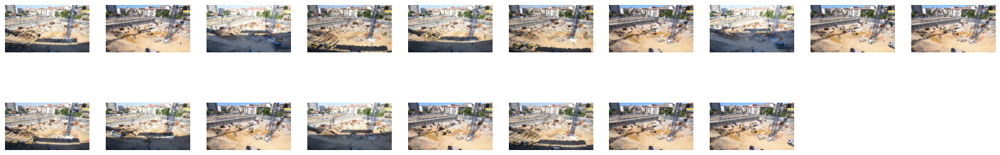

In [ ]:
# We can see that each cluster contains the same images
view_cluster(4)

In [ ]:
# In groups we can see all the image names of a same file
groups.get(0)

['Detection_Test_Set_Img/frame1631.jpg',
 'Detection_Test_Set_Img/frame1602.jpg',
 'Detection_Test_Set_Img/frame1592.jpg',
 'Detection_Test_Set_Img/frame1596.jpg',
 'Detection_Test_Set_Img/frame1624.jpg',
 'Detection_Test_Set_Img/frame1589.jpg',
 'Detection_Test_Set_Img/frame1578.jpg',
 'Detection_Test_Set_Img/frame1628.jpg',
 'Detection_Test_Set_Img/frame1585.jpg',
 'Detection_Test_Set_Img/frame1613.jpg',
 'Detection_Test_Set_Img/frame1606.jpg',
 'Detection_Test_Set_Img/frame1581.jpg',
 'Detection_Test_Set_Img/frame1617.jpg',
 'Detection_Test_Set_Img/frame1620.jpg']

In [ ]:
# This functions is used to register the images of the test set and to be 
# able to code it.

def dataset_function_test(group, group_number):
  
  # Extract the images names from a folder
  list_images = group.get(group_number)
  
  dataset_dicts = []
  # From the names extract the json file names and extract the relevant annotations:
  for idx, f in enumerate(list_images):
    # Find the json file related to the image
    
    # We read the image to get the metadata for the annotations and dataset registering
    height, width = cv2.imread(f).shape[:2]
    
    # With the format that is needed for the detectron2 (filename, image_id, height, weight)
    record = {}
    record["file_name"] = f
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width
    
    dataset_dicts.append(record)
  return dataset_dicts


In [ ]:
d= dataset_function_test(groups, 0)
d

[{'file_name': 'Detection_Test_Set_Img/frame1631.jpg',
  'height': 1080,
  'image_id': 0,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1602.jpg',
  'height': 1080,
  'image_id': 1,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1592.jpg',
  'height': 1080,
  'image_id': 2,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1596.jpg',
  'height': 1080,
  'image_id': 3,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1624.jpg',
  'height': 1080,
  'image_id': 4,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1589.jpg',
  'height': 1080,
  'image_id': 5,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1578.jpg',
  'height': 1080,
  'image_id': 6,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1628.jpg',
  'height': 1080,
  'image_id': 7,
  'width': 1920},
 {'file_name': 'Detection_Test_Set_Img/frame1585.jpg',
  'height': 1080,
  'image_id': 8,
  'width': 1920},
 {'file_name': 'Detection_Te

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


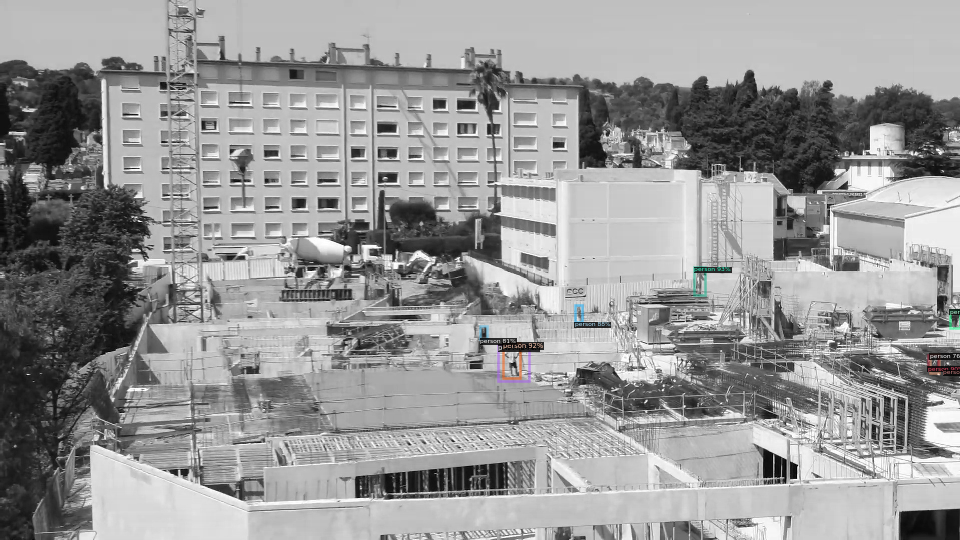

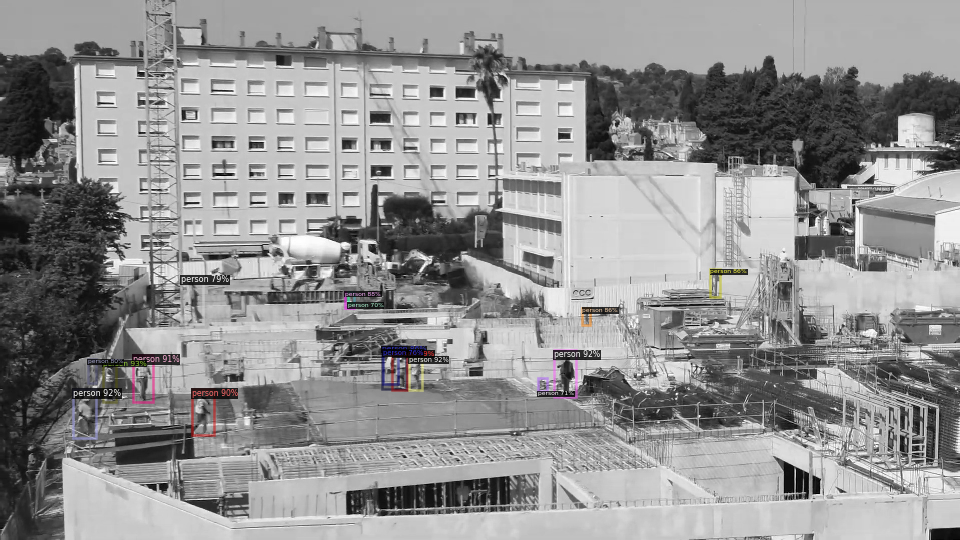

In [ ]:
from detectron2.utils.visualizer import ColorMode

# WHEN 0 we are referring to cluster 0 it could be changed from 0 to 6:
# This code will draw the predictions of 2 images of the first cluster
dataset_dicts = dataset_function_test(groups,0)
for d in random.sample(dataset_dicts, 2):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=worksites_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


cluster  1


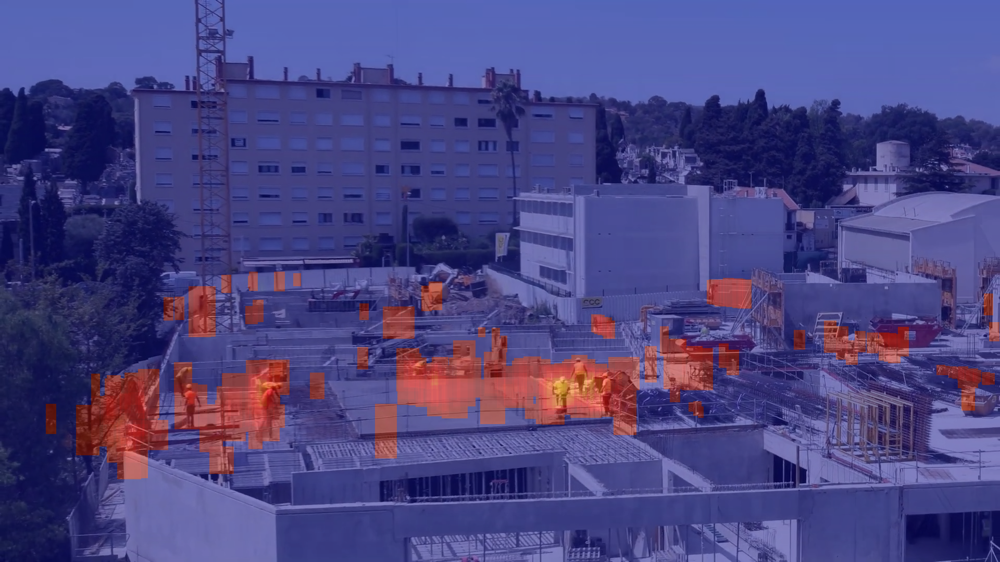

cluster  2


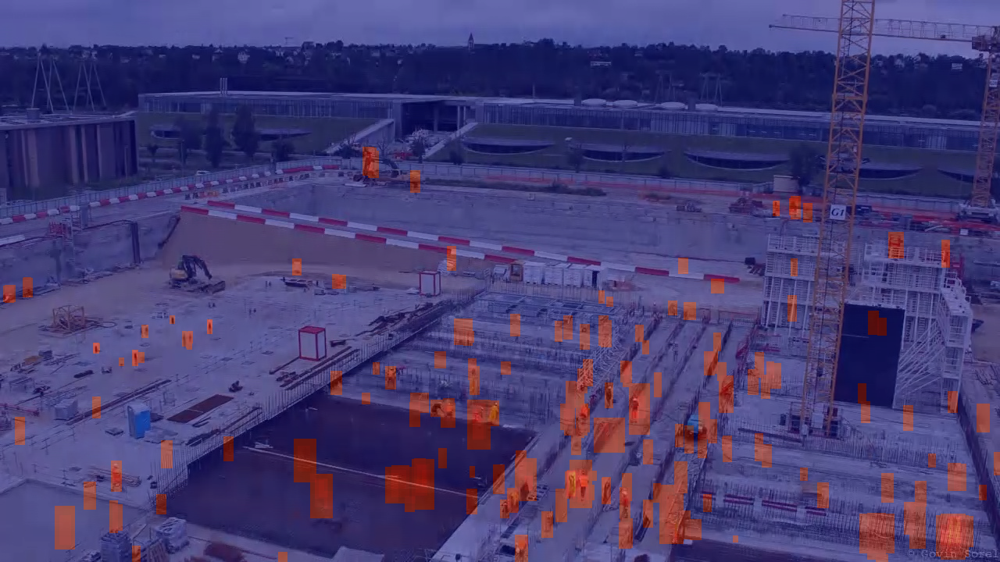

cluster  3


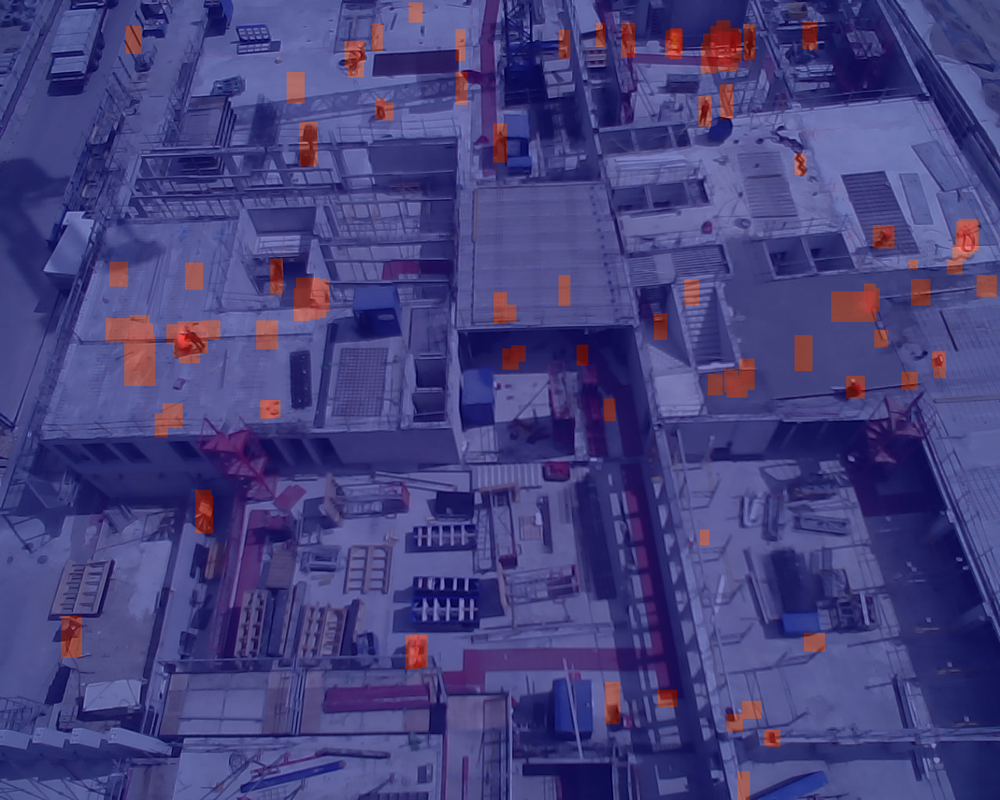

cluster  4


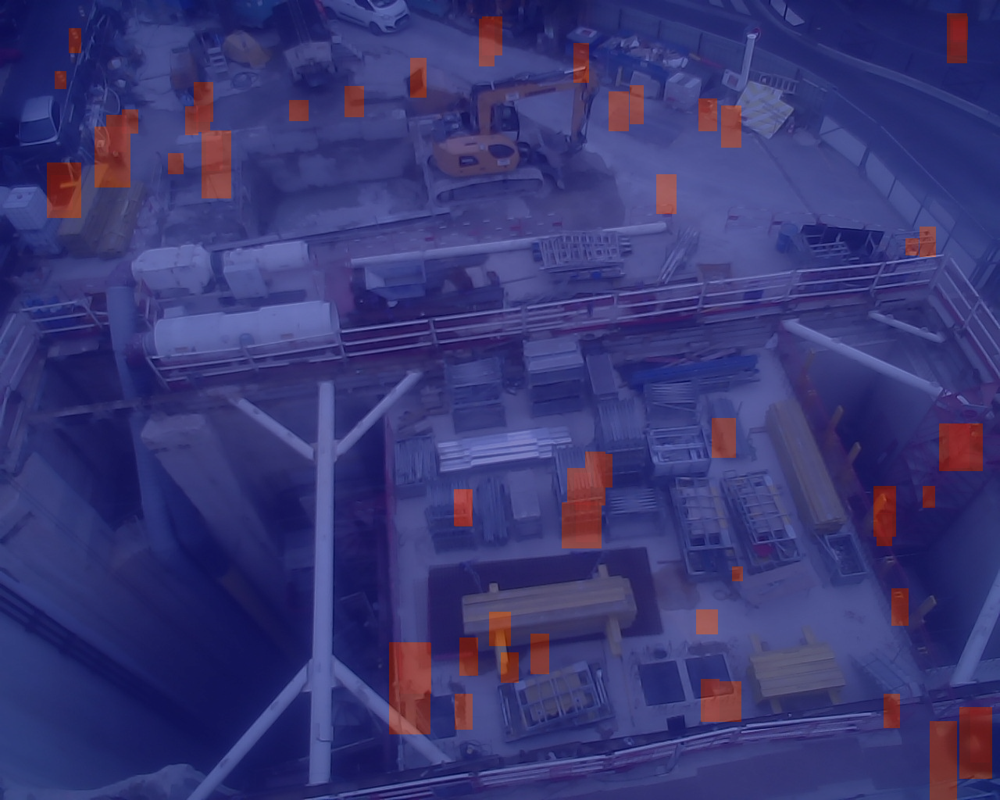

cluster  5


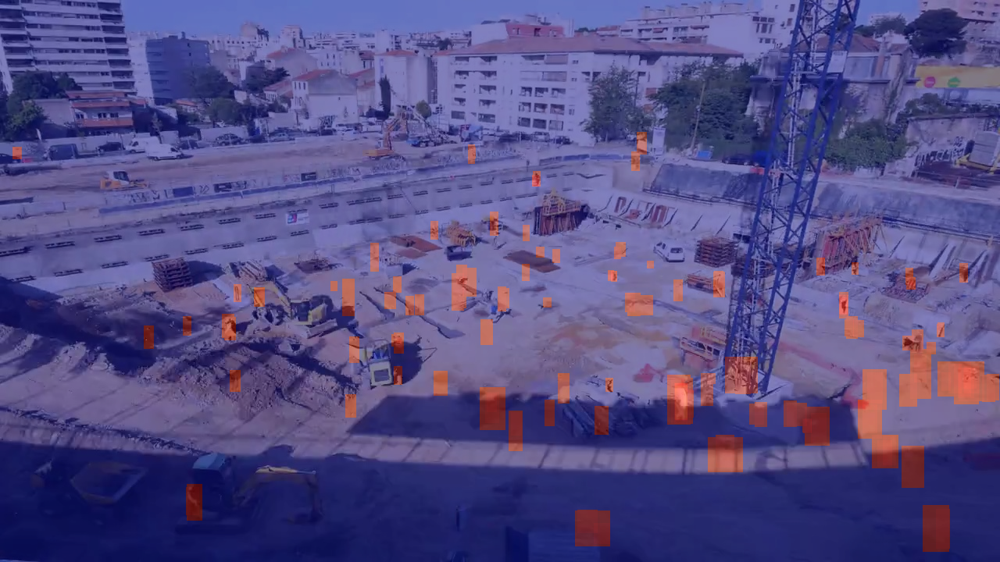

cluster  6


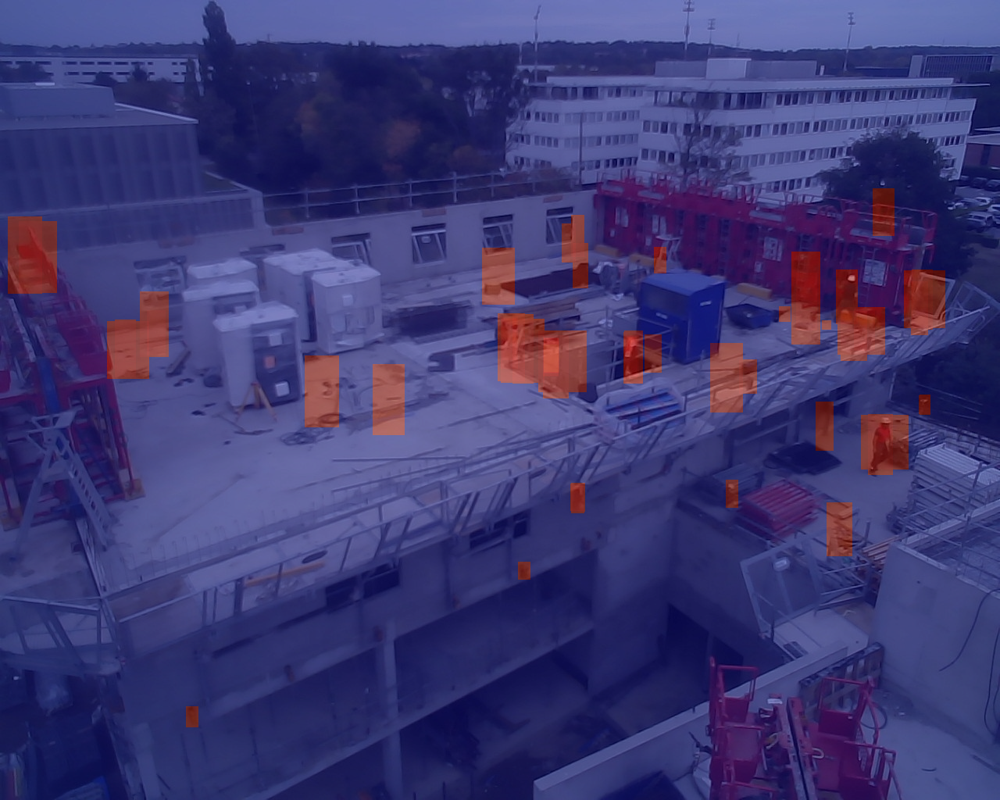

cluster  7


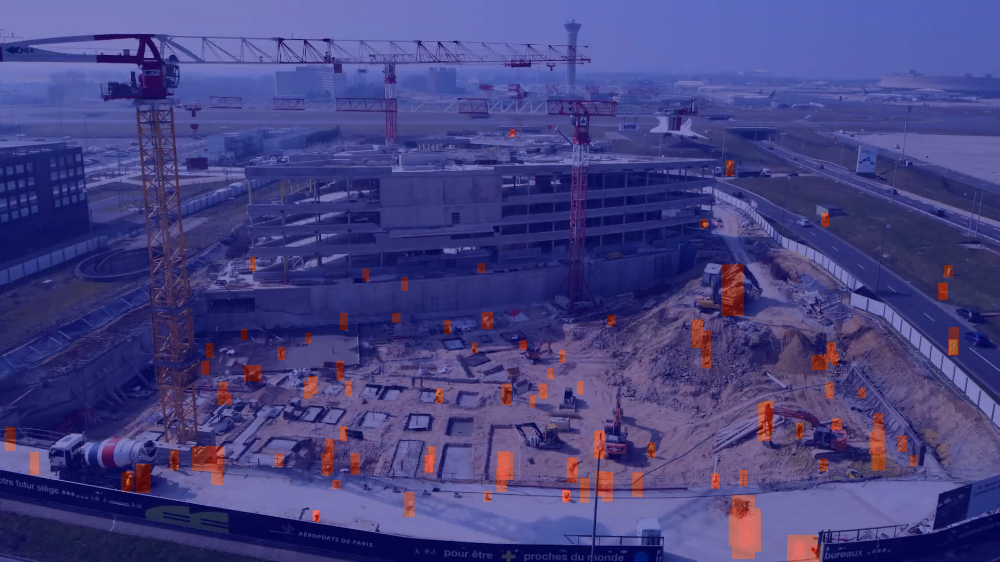

In [ ]:
from detectron2.utils.visualizer import ColorMode
import cv2 as cv

# Iterate the 7 clusters
for i in range(0,7):
  # get the height and width of the images of the cluster
  dataset_dicts = dataset_function_test(groups,i)
  h = dataset_dicts[0].get('height')
  w = dataset_dicts[0].get('width')
  
  # Create a matrix with 0s having the image size
  image_heatmap = np.zeros((h,w))
  
  # for every image do:
  for d in dataset_dicts:
    im = cv2.imread(d["file_name"])
    # get from the model the predicted persons in the image
    outputs = predictor(im)  
    boxes = outputs["instances"].get_fields()["pred_boxes"]
    for box in boxes:
      box_np = box.cpu().detach().numpy()
      box_np = np.floor(box_np).astype(int) 
      # For every annotation, add an arbritary number to those pixels (i.e. 5)    
      image_heatmap[box_np[1]:box_np[3],box_np[0]:box_np[2]] += 5

  print("cluster ", (i+1))

  # Get the image heatmap
  image_heatmap = cv2.applyColorMap(np.uint8(255 * image_heatmap), cv2.COLORMAP_JET)
  
  # Draw the first image and superpose the heatmaps
  src1 = cv.imread(cv.samples.findFile(dataset_dicts[0].get("file_name")))
  gray = cv2.cvtColor(src1, cv2.COLOR_BGR2GRAY)
    
  alpha = 0.5
  beta = (1.0 - alpha)

  dst = cv.addWeighted(src1, alpha, image_heatmap, beta, 0.0)
  cv2_imshow(dst)



In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("balloon_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "balloon_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[09/02 02:45:11 d2.evaluation.coco_evaluation]: 'balloon_val' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[09/02 02:45:11 d2.data.datasets.coco]: Converting annotations of dataset 'balloon_val' to COCO format ...)
[09/02 02:45:11 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[09/02 02:45:11 d2.data.datasets.coco]: Conversion finished, #images: 13, #annotations: 50
[09/02 02:45:11 d2.data.datasets.coco]: Caching COCO format annotations at './output/balloon_val_coco_format.json' ...
[09/02 02:45:12 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|  balloon   | 50           |
|            |              |
[09/02 02:45:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/02 02:45:12 d2.data.common]: Serializing 13 elements to